### Data Ingestion

In [ ]:
%sql
select count(distinct pitchdata_player_name)
from injury_acwr
where pos in ('RP', 'SP', 'RP/SP', 'SP/RP')

count(DISTINCT pitchdata_player_name)
884


In [ ]:
import pandas as pd
injury_df = spark.sql("""
select *, datediff(`Return Date`, `IL Retro Date`) as injury_duration
from injury_acwr
""").toPandas()
# injury_df['IL Retro Date'] = pd.to_datetime(injury_df['IL Retro Date'], errors='coerce')
injury_df = injury_df[injury_df['Pos'].isin(['RP', 'SP', 'SP/RP', 'RP/SP'])]
injured_players = list(injury_df['pitchdata_player_name'].unique())
spark.createDataFrame(injury_df).createOrReplaceTempView('injury_table')

In [ ]:
%sql
select * from injury_table

Name,Team,Pos,Injury / Surgery Date,Injury / Surgery,Status,IL Retro Date,Eligible to Return,Return Date,Latest Update,INCLUDE,pitchdata_player_name,Inclusion/Exclusion Criteria,injury_duration
A.J. Cole,TOR,RP,6/2/21,Neck discomfort,Activated,2021-05-30,2021-07-29,2021-09-06,Activated,Y,"Cole, A.J.",null,99.0
A.J. Minter,ATL,RP,7/8/23,Shoulder inflammation,Activated,2023-07-12,2023-07-27,2023-07-31,Activated,Y,"Minter, A.J.",null,19.0
A.J. Puk,MIA,RP,5/10/23,Elbow nerve irritation,Activated,2023-05-11,2023-05-26,2023-06-06,Activated,Y,"Puk, A.J.",null,26.0
A.J. Puk,OAK,RP,4/18/22,Undisclosed,Activated,2022-04-18,2022-04-19,2022-04-20,Activated,Y,"Puk, A.J.",null,2.0
A.J. Puk,OAK,SP/RP,4/6/21,Strained biceps,Activated,2021-04-07,2021-04-17,2021-05-28,Activated,Y,"Puk, A.J.",null,51.0
A.J. Puk,OAK,SP,9/16/20,Shoulder surgery,45-Day IL,2020-07-20,2020-09-03,2020-09-28,Out for 2020 season,Y,"Puk, A.J.",null,70.0
Aaron Ashby,MIL,SP,4/7/23,Arthroscopic shoulder surgery,60-Day IL,2023-03-27,2023-05-26,null,Rehab assignment (9/2),Y,"Ashby, Aaron",null,null
Aaron Ashby,MIL,SP,6/16/22,Forearm inflammation,Activated,2022-06-17,2022-07-02,2022-07-02,Activated,Y,"Ashby, Aaron",null,15.0
Aaron Ashby,MIL,SP,8/19/22,Shoulder inflammation,Activated,2022-08-20,2022-09-04,2022-09-20,Activated,Y,"Ashby, Aaron",null,31.0
Aaron Barrett,WSN,RP,9/18/20,Strained triceps,10-Day IL,2020-09-19,2020-09-29,2020-09-28,Out for 2020 season,Y,"Barrett, Aaron",null,9.0


### Preprocessing

In [ ]:
df = spark.sql("""
with XX as (
	select *, 
		row_number() over (partition by season, player_name order by game_date) as pitch_count, 
		concat(cast(game_date as varchar(10)), '-', at_bat_number) as at_bat,
		case when date_add(game_date, 1) = cast(`IL Retro Date` as date) then 1 else 0 end as is_injury_date,
		cast(`IL Retro Date` as date) as injury_date,
		case when pitch_name = '4-Seam Fastball' then 'FB'
					when pitch_name = 'Slider' then 'SL'
					when pitch_name = 'Sinker' then 'SI'
					when pitch_name = 'Changeup' then 'CH'
					when pitch_name = 'Cutter' then 'CU'
					else 'Other'
					end as pitch_type_binned,
		CASE
			WHEN `Injury / Surgery` = 'Ankle contusion' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Ankle discomfort' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Ankle impingement' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Ankle inflammation' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Ankle surgery' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Ankle tendinitis' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Fractured ankle' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Sprained ankle' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Strained ankle' THEN 'Ankle'
			WHEN `Injury / Surgery` = 'Arm fatigue' THEN 'Arm'
			WHEN `Injury / Surgery` = 'Arm inflammation' THEN 'Arm'
			WHEN `Injury / Surgery` = 'Arm tightness' THEN 'Arm'
			WHEN `Injury / Surgery` = 'Stress reaction -- arm' THEN 'Arm'
			WHEN `Injury / Surgery` = 'Ablation procedure (back)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back contusion' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back discomfort' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back soreness' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back spasms' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back stiffness' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back surgery' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back surgery (discectomy)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back surgery (herniated disc)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back surgery (lumbar discectomy)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Back tightness' THEN 'Back'
			WHEN `Injury / Surgery` = 'Benign bone tumor in spine' THEN 'Back'
			WHEN `Injury / Surgery` = 'Cervical nerve impingement' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lat surgery' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lat tightness' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back discomfort' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back inflammation' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back spasm' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back spasms' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back surgery' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lower back tightness' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lumbar spasm' THEN 'Back'
			WHEN `Injury / Surgery` = 'Lumbar spine stress reaction' THEN 'Back'
			WHEN `Injury / Surgery` = 'Microdiscectomy (back surgery)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained back (lumbar)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained back (trapezius)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained cervical spine' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained lat' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained lower back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained lumbar' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained upper back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Strained upper back (rhomboid)' THEN 'Back'
			WHEN `Injury / Surgery` = 'Stress fracture in lower back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Stress fracture, lower back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Stress reaction -- lower back' THEN 'Back'
			WHEN `Injury / Surgery` = 'Torn lat' THEN 'Back'
			WHEN `Injury / Surgery` = 'Torn lat tendon' THEN 'Back'
			WHEN `Injury / Surgery` = 'COVID-19' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 (protocol)' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 (symptoms)' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 (undisclosed)' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 (vaccination)' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 IL (undisclosed)' THEN 'Covid'
			WHEN `Injury / Surgery` = 'COVID-19 protocol' THEN 'Covid'
			WHEN `Injury / Surgery` = 'Arthoscopic elbow surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Arthroscopic elbow surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Blood clot removal surgery (right elbow)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Bone bruise in elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Bone chip in elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Bone spur in elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow contusion' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow debridement surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow discomfort' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow discomfort (lateral epicondylitis)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow discomfort (ulnar nerve entrapment)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow discomfort (ulnar neuritis)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow effusion' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow impingement' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow inflammation' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow laceration' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow nerve irritation' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow soreness' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow stress reaction' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (bone chip removal)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (bone chips)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (bone spur)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (flexor tendon/bone spur)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (fracture)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (hairline fracture)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (internal brace procedure)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (internal brace)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (loose bodies)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (loose body)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (stress fracture)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (UCL)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow surgery (ulnar nerve transposition)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow tendinitis' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow tightness' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow ulnar neuritis' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow valgus extension overload' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Elbow/Flexor tendon surgery (Tenex procedure)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Fractured elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Fractured elbow (right)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Olecranon stress fracture (right elbow)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Partially torn elbow ligament' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Sprained elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Strained elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Strained elbow flexor' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Strained mass flexor' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Stress reaction -- elbow' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Tommy John revision surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Tommy John surgery' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Tommy John surgery (revision)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Ulnar neuritis (elbow)' THEN 'Elbow'
			WHEN `Injury / Surgery` = 'Blister on foot' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Blister on toe' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Foot contusion' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Foot discomfort' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Foot metatarsalgia' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Foot surgery' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Fractured foot' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Fractured foot (fifth metatarsal)' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Fractured toe' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Plantar fascitis' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Sprained foot' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Sprained toe' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Stress reaction (toe)' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Toe sesamoiditis' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Turf toe' THEN 'Foot'
			WHEN `Injury / Surgery` = 'Blister -- finger (right index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister (index finger)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister (middle finger)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister (right index finger)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister (right middle finger)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on finger' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on finger (left index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on finger (left)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on finger (right index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on finger (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on hand' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blister on right hand' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blisters (left hand)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Blisters (right hand)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Carpal tunnel syndrome surgery' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Cracked fingernail' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Cracked fingernail/blister' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Cracked nail (middle finger)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger contusion' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger contusion (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger discomfort' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger discomfort (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger inflammation (right index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger inflammation (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger laceration' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger laceration (right index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger laceration (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Finger surgery (left ring)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fingernail avulsion (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured finger' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured finger (left ring)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured finger (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured hand (left)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured hand (non-throwing)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured hand (right pinkie)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Fractured hand (right)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Hand contusion' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Hand inflammation' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Non-displaced thumb fracture (right)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Ruptured finger pulley' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Split fingernail' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained finger' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained finger (left middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained finger (left ring)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained finger (right index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained finger (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained left thumb' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Sprained thumb' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Strained finger' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Strained finger (left index)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Strained finger (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Thumb abrasion (right)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Thumb contusion' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Thumb surgery (laceration)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Thumb surgery (torn ligament)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Thumb weakness (left)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Torn finger tendon (right middle)' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Torn flexor tendon' THEN 'Hand'
			WHEN `Injury / Surgery` = 'Concussion' THEN 'Head'
			WHEN `Injury / Surgery` = 'Face surgery (OZMC fracture)' THEN 'Head'
			WHEN `Injury / Surgery` = 'Facial fractures' THEN 'Head'
			WHEN `Injury / Surgery` = 'Facial surgery' THEN 'Head'
			WHEN `Injury / Surgery` = 'Fractured nose' THEN 'Head'
			WHEN `Injury / Surgery` = 'Nasal fracture surgery' THEN 'Head'
			WHEN `Injury / Surgery` = 'Skull fracture' THEN 'Head'
			WHEN `Injury / Surgery` = 'Groin inflammation' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Groin tightness' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip discomfort' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip impingement' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip inflammation' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip surgery' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip surgery (labrum repair)' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip surgery (torn labrum)' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Hip tightness' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'SI joint inflammation' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'SI joint inflammation (hip)' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Sports hernia surgery' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Strained groin' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Strained hip' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Strained hip flexor' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Strained right groin' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Testicular contusion' THEN 'Hip/Groin'
			WHEN `Injury / Surgery` = 'Appendicitis' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Flu-like symptoms' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Illness' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Mononucleosis' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Non-COVID illness' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Non-viral illness' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Viral infection' THEN 'Illness'
			WHEN `Injury / Surgery` = 'Arthroscopic knee surgery' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee contusion' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee discomfort' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee effusion' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee inflammation' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee soreness' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (cyst removal)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (debridement)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (loose bodies)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (patellar tendon)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (torn ACL)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (torn meniscus)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (torn patellar tendon)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee surgery (torn tendon)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Knee tendinitis' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Sprained knee' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Sprained knee (torn MCL)' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Strained knee' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Torn knee ligament' THEN 'Knee'
			WHEN `Injury / Surgery` = 'Flexor tendon surgery' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Flexor tendon/Tommy John revision surgery' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm contusion' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm discomfort' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm fatigue' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm inflammation' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm inflammtion' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm nerve inflammation' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm soreness' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm sugery (nerve decompression)' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm tendinitis' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Forearm tightness' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Hairline stress fracture (forearm)' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Radial nerve irritation' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Radial stress fracture, forearm)' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Sprained wrist' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Strained flexor' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Strained flexor tendon' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Strained forearm' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Strained forearm flexor' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Strained wrist' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Ulnar nerve irritation' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Ulnar nerve transposition surgery' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Ulnar neuritis' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Wrist contusion' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Wrist inflammation' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Wrist surgery' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Wrist surgery (fracture)' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Wrist tendinitis' THEN 'Lower Arm'
			WHEN `Injury / Surgery` = 'Achilles tendinitis' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Achilles'' tendon surgery' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Achilles'' tendon surgery (exploratory)' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Calf contusion' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Calf inflammation' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Leg discomfort' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Leg infection' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Lower leg tightness' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Patellar tendinitis' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Patellar tendonitis' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Shin contusion' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Strained calf' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Strained lower leg' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Stress reaction -- shin' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Stress reaction in leg' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Stress reaction to tibia' THEN 'Lower Leg'
			WHEN `Injury / Surgery` = 'Esophageal constriction' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Neck discomfort' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Neck inflammation' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Neck nerve irritation' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Neck spasms' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Neck tightness' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Strained neck' THEN 'Neck'
			WHEN `Injury / Surgery` = 'Anxiety' THEN 'Other'
			WHEN `Injury / Surgery` = 'Atrial fibrillation surgery' THEN 'Other'
			WHEN `Injury / Surgery` = 'Blister' THEN 'Other'
			WHEN `Injury / Surgery` = 'Blisters' THEN 'Other'
			WHEN `Injury / Surgery` = 'Bruised lung' THEN 'Other'
			WHEN `Injury / Surgery` = 'Elbow soreness / Strained hamstring' THEN 'Other'
			WHEN `Injury / Surgery` = 'Elbow/back soreness' THEN 'Other'
			WHEN `Injury / Surgery` = 'Gastroenteritis' THEN 'Other'
			WHEN `Injury / Surgery` = 'Hodgkin''s Lymphoma' THEN 'Other'
			WHEN `Injury / Surgery` = 'Irregular heartbeat' THEN 'Other'
			WHEN `Injury / Surgery` = 'Kidney ailment' THEN 'Other'
			WHEN `Injury / Surgery` = 'Kidney stones' THEN 'Other'
			WHEN `Injury / Surgery` = 'Mental health' THEN 'Other'
			WHEN `Injury / Surgery` = 'Non-Hodgkin''s Lymphoma' THEN 'Other'
			WHEN `Injury / Surgery` = 'Raynaud''s syndrome surgery' THEN 'Other'
			WHEN `Injury / Surgery` = 'TBD' THEN 'Other'
			WHEN `Injury / Surgery` = 'Ulcerative colitis' THEN 'Other'
			WHEN `Injury / Surgery` = 'Undisclosed' THEN 'Other'
			WHEN `Injury / Surgery` = 'Undisclosed medical condition' THEN 'Other'
			WHEN `Injury / Surgery` = 'AC joint inflammation' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Arthroscopic shoulder surgery' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Arthroscopic shoulder surgery (posterior labrum)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Flexor tendon surgery/Shoulder soreness' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Posterior shoulder discomfort' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Rotator cuff inflammation' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Rotator cuff tendinitis' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder bursitis' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder contusion' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder discomfort' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder discomfort (scapular stress fracture)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder dislocation (non-throwing)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder fatigue' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder impingement' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder impingement syndrome' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder inflammation' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder inflammation (scapula)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder inflammation (SI joint)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder nerve inflammation' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder nerve irritation' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder soreness' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder soreness (frayed labrum)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder subluxation (non-throwing)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (aneurysm)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (anterior capsule repair)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (cyst removal)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (glenohumeral ligaments and capsu' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (labral debridement)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (labrum debridement)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (labrum/rotator cuff cleanup)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (labrum/rotator cuff repair)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (torn capsule)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder surgery (torn labrum)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder tendinitis' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder tendinitis (rotator cuff)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder tendinopathy' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder tendonitis (rotator cuff)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Shoulder tightness' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Sprained shoulder' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained lat/Torn shoulder capsule' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained rotator cuff' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder (capsular tear)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder (deltoid)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder (posterior capsule)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder (rotator cuff)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained shoulder (teres major)' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Strained teres major' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Stress fracture -- shoulder' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Stress reaction -- shoulder' THEN 'Shoulder'
			WHEN `Injury / Surgery` = 'Abscess removal procedure (thigh)' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Glute soreness' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Hamstring surgery' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Hamstring tendinitis' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Hamstring tendonitis' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Strained adductor' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Strained glute' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Strained hamstring' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Strained quad' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Thigh inflammation' THEN 'Thigh'
			WHEN `Injury / Surgery` = 'Biceps contusion' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps discomfort' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps inflammation' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps nerve injury' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps tendinitis' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps tendon inflammation' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps tendonitis' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Biceps tightness' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Strained biceps' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Strained triceps' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Triceps discomfort' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Triceps inflammation' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Triceps soreness' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Triceps tendinitis' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Triceps tightness' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Vascular surgery (upper arm aneurysm)' THEN 'Upper Arm'
			WHEN `Injury / Surgery` = 'Abdominal discomfort' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Abdominal surgery' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Bone graft surgery (rib)' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Chest contusion' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Fractured rib' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Intercostal irritation' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Oblique soreness' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Pectoral tightness' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Rib costochondritis' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Side discomfort' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Side tightness' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Sprained ribcage' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Sprained SC joint' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Strained abdominal' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Strained intercostal' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Strained oblique' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Strained pectoral' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Strained rib cage' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Stress fracture -- rib cage' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Stress reaction -- ribs' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Thoracic outlet syndrome' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Thoracic outlet syndrome surgery' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Thoracic outlet syndrome surgery (follow-up proced' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Thoracic spine inflammation' THEN 'Upper Body'
			WHEN `Injury / Surgery` = 'Thoracic spine tightness' THEN 'Upper Body'
			END AS Injury_Location
	from (
		select *, year(game_date) as season
		from acwr_data x
		where player_name in (select distinct pitchdata_player_name from injury_table)
	) x 
	left join (
		select *, year(cast(`IL Retro Date` as date)) as injury_season, injury_duration
		from injury_table y 
	) y on x.player_name = y.pitchdata_player_name and x.game_date between date_sub(`IL Retro Date`, 3) and cast(`IL Retro Date` as date)
)
select *
from XX
""")

df.createOrReplaceTempView('tbl')
display(df)

pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,spin_dir,spin_rate_deprecated,break_angle_deprecated,break_length_deprecated,zone,des,game_type,stand,p_throws,home_team,away_team,type,hit_location,bb_type,balls,strikes,game_year,pfx_x,pfx_z,plate_x,plate_z,on_3b,on_2b,on_1b,outs_when_up,inning,inning_topbot,hc_x,hc_y,tfs_deprecated,tfs_zulu_deprecated,fielder_2,umpire,sv_id,vx0,vy0,vz0,ax,ay,az,sz_top,sz_bot,hit_distance_sc,launch_speed,launch_angle,effective_speed,release_spin_rate,release_extension,game_pk,pitcher_1,fielder_2_1,fielder_3,fielder_4,fielder_5,fielder_6,fielder_7,fielder_8,fielder_9,release_pos_y,estimated_ba_using_speedangle,estimated_woba_using_speedangle,woba_value,woba_denom,babip_value,iso_value,launch_speed_angle,at_bat_number,pitch_number,pitch_name,home_score,away_score,bat_score,fld_score,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp,season,Name,Team,Pos,Injury / Surgery Date,Injury / Surgery,Status,IL Retro Date,Eligible to Return,Return Date,Latest Update,INCLUDE,pitchdata_player_name,Inclusion/Exclusion Criteria,injury_duration,injury_season,injury_duration,pitch_count,at_bat,is_injury_date,injury_date,pitch_type_binned,Injury_Location
SI,2019-04-03,92.5,1.11,5.72,"Alexander, Scott",621453,518397,strikeout,swinging_strike,NA,NA,NA,NA,14,Steven Duggar strikes out swinging.,R,L,L,LAD,SF,S,2,null,2,2,2019,1.19,0.52,0.42,0.97,NA,NA,NA,2,7,Top,NA,NA,NA,NA,605131,NA,NA,-4.28814288344381,-134.466656916842,-7.36141122243942,15.1452324177928,28.8825757535354,-24.6406931500871,3.41,1.56,NA,NA,NA,91.9,2275,6,565805,518397,605131,501896,571771,457759,608369,621035,572041,641355,54.54,NA,NA,0,1,0,0,NA,53,5,Sinker,2,3,3,2,3,2,3,2,Standard,Standard,114,0.012,-0.099,2019,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1,2019-04-03-53,0,null,SI,null
SI,2019-04-03,93.4,1.18,5.54,"Alexander, Scott",621453,518397,null,ball,NA,NA,NA,NA,13,Steven Duggar strikes out swinging.,R,L,L,LAD,SF,B,NA,null,1,2,2019,1.16,0.17,-2.01,0.27,NA,NA,NA,2,7,Top,NA,NA,NA,NA,605131,NA,NA,-10.5598890640296,-135.364637157476,-8.05264857042056,16.2596345321222,28.3747144629499,-28.6259587443963,3.46,1.59,NA,NA,NA,92.3,2252,5.8,565805,518397,605131,501896,571771,457759,608369,621035,572041,641355,54.72,NA,NA,NA,NA,NA,NA,NA,53,4,Sinker,2,3,3,2,3,2,3,2,Standard,Standard,99,0,0.019,2019,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2,2019-04-03-53,0,null,SI,null
SI,2019-04-03,94.4,1.14,5.65,"Alexander, Scott",621453,518397,null,foul,NA,NA,NA,NA,13,Steven Duggar strikes out swinging.,R,L,L,LAD,SF,S,NA,null,1,1,2019,1.16,0.66,-0.64,1.46,NA,NA,NA,2,7,Top,NA,NA,NA,NA,605131,NA,NA,-7.09981948960189,-137.103327603446,-6.59833382207238,15.9517755296525,28.4054657211506,-22.8437716321881,3.47,1.59,NA,NA,NA,93.7,2300,5.9,565805,518397,605131,501896,571771,457759,608369,621035,572041,641355,54.65,NA,NA,NA,NA,NA,NA,NA,53,3,Sinker,2,3,3,2,3,2,3,2,Standard,Standard,120,0,-0.028,2019,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,3,2019-04-03-53,0,null,SI,null
SL,2019-04-03,85,1.14,5.63,"Alexander, Scott",621453,518397,null,ball,NA,NA,NA,NA,13,Steven Duggar strikes out swinging.,R,L,L,LAD,SF,B,NA,null,0,1,2019,-0.21,-0.21,-2.06,-0.1,NA,NA,NA,2,7,Top,NA,NA,NA,NA,605131,NA,NA,-7.01256749210574,-123.526990102322,-6.68352763675707,-0.893274181785786,22.4588005323172,-33.2936032822297,3.47,1.59,NA,NA,NA,84.7,2274,6,565805,518397,605131,501896,571771,457759,608369,621035,572041,641355,54.54,NA,NA,NA,NA,NA,NA,NA,53,2,Slider,2,3,3,2,3,2,3,2,Standard,Standard,314,0,0.012,2019,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,4,2019-04-03-53,0,null,SL,null
SI,2019-04-03,93.8,1.15,5.69,"Alexander, Scott",621453,518397,null,foul_tip,NA,NA,NA,NA,8,Steven Duggar strikes out swinging.,R,L

In [ ]:
%sql
select distinct player_name, injury_date
from tbl
where injury_season is not null

player_name,injury_date
"Silseth, Chase",2023-08-27
"Wright, Kyle",2023-05-04
"Maeda, Kenta",2023-04-27
"Pérez, Eury",2023-09-21
"Freeland, Kyle",2023-09-17
"Winn, Keaton",2023-09-19
"Vasquez, Andrew",2023-08-28
"Boxberger, Brad",2023-09-22
"Acevedo, Domingo",2023-04-11
"Singer, Brady",2023-09-19


### Deriving pACWR Candidate Metrics

In [ ]:
%sql
WITH pitch_counts AS (
    SELECT player_name,
           team,
           spin_axis,
           pitch_number,
           at_bat_number,
           pitch_name,
           release_spin_rate,
           effective_speed,
           release_extension,
           game_date,
           game_year,
           injury_season,
           inning,
           pos,
           pitch_type_binned,
           is_injury_date,
           p_throws,
           `Injury / Surgery` as injury_type,
           injury_location,
           `IL Retro Date` as il_retro_date,
           `Eligible to Return` as return_eligible,
           `Return Date` as return_date,
           (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS pc_1_wk,
            (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS pc_4_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS spin_1_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS spin_4_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS speed_1_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS speed_4_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS bf_1_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS bf_4_wk
    FROM tbl AS p1
)
select pitch_counts.*,
  x.pct_fastball,
  x.pct_slider,
  x.pct_sinker,
  x.pct_changeup,
  x.pct_cutter,
  CASE WHEN pc_4_wk <> 0 THEN cast(pc_1_wk as int) / cast(pc_4_wk as float) ELSE NULL END AS pACWR_pitch_count,
  CASE WHEN spin_4_wk <> 0 THEN cast(spin_1_wk as int) / cast(spin_4_wk as float) ELSE NULL END AS pACWR_spin_rate,
  CASE WHEN speed_4_wk <> 0 THEN cast(speed_1_wk as int) / cast(speed_4_wk as float) ELSE NULL END as pACWR_speed,
  CASE WHEN bf_4_wk <> 0 THEN cast(bf_1_wk as int) / cast(bf_4_wk as float) ELSE NULL END as pACWR_batters_faced
FROM pitch_counts
left join (
  select player_name,
  avg(release_speed) as avg_speed,
  avg(release_spin_rate) as avg_spin_rate,
  sum(case when pitch_type_binned = 'FB' then 1 else 0 end)/cast(count(*) as float) as pct_fastball,
  sum(case when pitch_type_binned = 'SL' then 1 else 0 end)/cast(count(*) as float) as pct_slider,
  sum(case when pitch_type_binned = 'SI' then 1 else 0 end)/cast(count(*) as float) as pct_sinker,
  sum(case when pitch_type_binned = 'CH' then 1 else 0 end)/cast(count(*) as float) as pct_changeup,
  sum(case when pitch_type_binned = 'CU' then 1 else 0 end)/cast(count(*) as float) as pct_cutter
  from tbl
  group by 1
) x on pitch_counts.player_name = x.player_name
order by player_name, game_date

player_name,team,spin_axis,pitch_number,at_bat_number,pitch_name,release_spin_rate,effective_speed,release_extension,game_date,game_year,injury_season,inning,pos,pitch_type_binned,is_injury_date,p_throws,injury_type,injury_location,il_retro_date,return_eligible,return_date,pc_1_wk,pc_4_wk,spin_1_wk,spin_4_wk,speed_1_wk,speed_4_wk,bf_1_wk,bf_4_wk,pct_fastball,pct_slider,pct_sinker,pct_changeup,pct_cutter,pACWR_pitch_count,pACWR_spin_rate,pACWR_speed,pACWR_batters_faced
"Abreu, Albert",null,236,1,45,4-Seam Fastball,2045,97.8,6.7,2020-08-08,2020,null,5,null,FB,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,232,6,52,4-Seam Fastball,2053,95,6.6,2020-08-08,2020,null,6,null,FB,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,30,2,41,Curveball,2638,82,6.3,2020-08-08,2020,null,5,null,Other,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,252,4,41,Changeup,2006,86.6,6.7,2020-08-08,2020,null,5,null,CH,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,231,2,46,4-Seam Fastball,2044,96.3,6.6,2020-08-08,2020,null,5,null,FB,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,247,2,45,Changeup,1931,87.5,6.6,2020-08-08,2020,null,5,null,CH,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,232,2,47,4-Seam Fastball,1954,96.4,6.5,2020-08-08,2020,null,5,null,FB,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,173,4,52,Slider,2121,86,6.4,2020-08-08,2020,null,6,null,SL,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,148,1,44,Slider,2131,86.5,6.6,2020-08-08,2020,null,5,null,SL,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0
"Abreu, Albert",null,228,1,43,4-Seam Fastball,2106,98.1,6.6,2020-08-08,2020,null,5,null,FB,0,R,null,null,null,null,null,41,41,2046.560975609756,2046.560975609756,90.77804878048778,90.77804878048778,10,10,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,1.0,0.9997258644396075,0.991429142931102,1.0


In [ ]:
%sql
create or replace temp view injury_pacwr as (
WITH pitch_counts AS (
    SELECT player_name,
           game_date,
           pos,
           is_injury_date,
           injury_date,
           `Injury / Surgery` as injury_type,
           injury_location,
           (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS pc_1_wk,
            (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS pc_4_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS spin_1_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS spin_4_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS speed_1_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS speed_4_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS bf_1_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS bf_4_wk
    FROM tbl AS p1
)
select distinct
  game_date,
  pos,
  injury_type,
  injury_location,
  x.*,
  CASE WHEN pc_4_wk <> 0 THEN cast(pc_1_wk as int) / cast(pc_4_wk as float) ELSE NULL END AS pACWR_pitch_count,
  CASE WHEN spin_4_wk <> 0 THEN cast(spin_1_wk as int) / cast(spin_4_wk as float) ELSE NULL END AS pACWR_spin_rate,
  CASE WHEN speed_4_wk <> 0 THEN cast(speed_1_wk as int) / cast(speed_4_wk as float) ELSE NULL END as pACWR_speed,
  CASE WHEN bf_4_wk <> 0 THEN cast(bf_1_wk as int) / cast(bf_4_wk as float) ELSE NULL END as pACWR_batters_faced
FROM pitch_counts
left join (
  select player_name,
  avg(release_speed) as avg_speed,
  avg(release_spin_rate) as avg_spin_rate,
  sum(case when pitch_type_binned = 'FB' then 1 else 0 end)/cast(count(*) as float) as pct_fastball,
  sum(case when pitch_type_binned = 'SL' then 1 else 0 end)/cast(count(*) as float) as pct_slider,
  sum(case when pitch_type_binned = 'SI' then 1 else 0 end)/cast(count(*) as float) as pct_sinker,
  sum(case when pitch_type_binned = 'CH' then 1 else 0 end)/cast(count(*) as float) as pct_changup,
  sum(case when pitch_type_binned = 'CU' then 1 else 0 end)/cast(count(*) as float) as pct_cutter
  from tbl
  group by 1
) x on pitch_counts.player_name = x.player_name
where is_injury_date = 1
order by player_name, game_date
)

In [ ]:
%sql
WITH pitch_counts AS (
    SELECT player_name,
           game_date,
           pos,
           is_injury_date,
           injury_date,
           `Injury / Surgery` as injury_type,
           injury_location,
           case when game_date between date_sub(injury_date, 10) and injury_date then 1 else 0 end as within_10_days_inj,
           injury_duration,
           (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS pc_1_wk,
            (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS pc_4_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS spin_1_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS spin_4_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS speed_1_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS speed_4_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS bf_1_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS bf_4_wk
    FROM tbl AS p1
)
, final as (
  select distinct
    game_date,
    pos,
    injury_date,
    injury_type,
    injury_location,
    is_injury_date,
    within_10_days_inj,
    injury_duration,
    x.*,
    CASE WHEN pc_4_wk <> 0 THEN cast(pc_1_wk as int) / cast(pc_4_wk as float) ELSE NULL END AS pACWR_pitch_count,
    CASE WHEN spin_4_wk <> 0 THEN cast(spin_1_wk as int) / cast(spin_4_wk as float) ELSE NULL END AS pACWR_spin_rate,
    CASE WHEN speed_4_wk <> 0 THEN cast(speed_1_wk as int) / cast(speed_4_wk as float) ELSE NULL END as pACWR_speed,
    CASE WHEN bf_4_wk <> 0 THEN cast(bf_1_wk as int) / cast(bf_4_wk as float) ELSE NULL END as pACWR_batters_faced
  FROM pitch_counts
  left join (
    select player_name,
    avg(release_speed) as avg_speed,
    avg(release_spin_rate) as avg_spin_rate,
    sum(case when pitch_type_binned = 'FB' then 1 else 0 end)/cast(count(*) as float) as pct_fastball,
    sum(case when pitch_type_binned = 'SL' then 1 else 0 end)/cast(count(*) as float) as pct_slider,
    sum(case when pitch_type_binned = 'SI' then 1 else 0 end)/cast(count(*) as float) as pct_sinker,
    sum(case when pitch_type_binned = 'CH' then 1 else 0 end)/cast(count(*) as float) as pct_changup,
    sum(case when pitch_type_binned = 'CU' then 1 else 0 end)/cast(count(*) as float) as pct_cutter
    from tbl
    group by 1
  ) x on pitch_counts.player_name = x.player_name
  order by player_name, game_date
)
, XX as (
  select player_name, injury_date, injury_location, injury_duration, avg(pACWR_pitch_count) as avg_pacwr, max(pACWR_pitch_count) as max_pacwr
  FROM final
  where final.is_injury_date = 1
  group by 1, 2, 3, 4
)
select *
-- injury_location, avg(avg_pacwr), max(max_pacwr)
FROM XX
-- group by 1

player_name,injury_date,injury_location,injury_duration,avg_pacwr,max_pacwr
"Akin, Keegan",2021-09-23,Upper Body,null,0.27125506072874495,0.27125506072874495
"Doolittle, Sean",2022-04-20,Elbow,169.0,0.546875,0.546875
"Misiewicz, Anthony",2023-05-20,Lower Leg,21.0,0.7362637362637363,0.7362637362637363
"Nova, Iván",2020-08-15,Upper Arm,44.0,0.44642857142857145,0.44642857142857145
"Underwood Jr., Duane",2021-09-05,Shoulder,null,0.21243523316062177,0.21243523316062177
"Cabrera, Edward",2021-10-01,Hand,null,0.344311377245509,0.344311377245509
"Finnegan, Kyle",2021-06-21,Thigh,15.0,0.14545454545454545,0.14545454545454545
"Harvey, Matt",2020-09-16,Back,12.0,0.11320754716981132,0.11320754716981132
"Font, Wilmer",2020-09-07,Lower Leg,10.0,0.3181818181818182,0.3181818181818182
"Graveman, Kendall",2020-08-03,Back,29.0,1.0,1.0


Databricks visualization. Run in Databricks to view.

### Statistical Testing

In [ ]:
ttest_df = spark.sql("""
WITH pitch_counts AS (
    SELECT player_name,
           game_date,
           pos,
           is_injury_date,
           injury_date,
           `Injury / Surgery` as injury_type,
           injury_location,
           case when game_date between date_sub(injury_date, 7) and injury_date then 1 else 0 end as within_7_days_inj,
           (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS pc_1_wk,
            (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS pc_4_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS spin_1_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS spin_4_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS speed_1_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS speed_4_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS bf_1_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS bf_4_wk
    FROM tbl AS p1
)
, final as (
  select distinct
    game_date,
    pos,
    injury_date,
    injury_type,
    injury_location,
    is_injury_date,
    within_7_days_inj,
    x.*,
    CASE WHEN pc_4_wk <> 0 THEN cast(pc_1_wk as int) / cast(pc_4_wk as float) ELSE NULL END AS pACWR_pitch_count,
    CASE WHEN spin_4_wk <> 0 THEN cast(spin_1_wk as int) / cast(spin_4_wk as float) ELSE NULL END AS pACWR_spin_rate,
    CASE WHEN speed_4_wk <> 0 THEN cast(speed_1_wk as int) / cast(speed_4_wk as float) ELSE NULL END as pACWR_speed,
    CASE WHEN bf_4_wk <> 0 THEN cast(bf_1_wk as int) / cast(bf_4_wk as float) ELSE NULL END as pACWR_batters_faced
  FROM pitch_counts
  left join (
    select player_name,
    avg(release_speed) as avg_speed,
    avg(release_spin_rate) as avg_spin_rate,
    sum(case when pitch_type_binned = 'FB' then 1 else 0 end)/cast(count(*) as float) as pct_fastball,
    sum(case when pitch_type_binned = 'SL' then 1 else 0 end)/cast(count(*) as float) as pct_slider,
    sum(case when pitch_type_binned = 'SI' then 1 else 0 end)/cast(count(*) as float) as pct_sinker,
    sum(case when pitch_type_binned = 'CH' then 1 else 0 end)/cast(count(*) as float) as pct_changup,
    sum(case when pitch_type_binned = 'CU' then 1 else 0 end)/cast(count(*) as float) as pct_cutter
    from tbl
    group by 1
  ) x on pitch_counts.player_name = x.player_name
  order by player_name, game_date
)
, XX as (
  select player_name, within_7_days_inj, injury_date, injury_location, avg(pACWR_pitch_count) as avg_pacwr
  FROM final
  where pACWR_pitch_count <> 1
  group by 1, 2, 3, 4
)
select *
-- injury_location, avg(avg_pacwr), max(max_pacwr)
FROM XX
-- group by 1
""").toPandas()

In [ ]:
ttest_df

,player_name,within_7_days_inj,injury_date,injury_location,avg_pacwr
0,"Antone, Tejay",1,2021-06-25,Lower Arm,0.200466
1,"Barrett, Aaron",0,None,None,0.426471
2,"Duarte, Daniel",0,None,None,0.413600
3,"Lange, Alex",0,None,None,0.343916
4,"Lovelady, Richard",0,None,None,0.411139
...,...,...,...,...,...
1998,"Oller, Adam",1,2022-09-04,Upper Body,0.274059
1999,"Sandoval, Patrick",1,2023-09-25,Upper Body,0.372460
2000,"Sheffield, Justus",1,2021-07-07,Lower Arm,0.370023
2001,"Thompson, Ryan",0,None,None,0.352253


In [ ]:
# Print the variance of both data groups
import numpy as np
data_group1 = ttest_df[ttest_df['within_7_days_inj'] == 1]['avg_pacwr']
data_group2 = ttest_df[ttest_df['within_7_days_inj'] == 0]['avg_pacwr']
print(np.var(data_group1), np.var(data_group2), np.var(data_group1) / np.var(data_group2))
print(np.mean(data_group1), np.mean(data_group2))
print(len(data_group1), len(data_group2))

0.02609405126307506 0.004776504120764657 5.463001936842826
0.38652130589086936 0.40545785638193765
1153 850


In [ ]:

# Python program to demonstrate how to 
# perform two sample T-test
 
# Import the library
import scipy.stats as stats
 
# Perform the two sample t-test with equal variances
stats.ttest_ind(a=data_group1, b=data_group2, equal_var=False).pvalue

0.0003797513383392376

In [ ]:
%sql
WITH pitch_counts AS (
    SELECT player_name,
           game_date,
           pos,
           is_injury_date,
           injury_date,
           `Injury / Surgery` as injury_type,
           injury_location,
           case when game_date between date_sub(injury_date, 10) and injury_date then 1 else 0 end as within_10_days_inj,
           (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS pc_1_wk,
            (SELECT COUNT(*)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS pc_4_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS spin_1_wk,
            (SELECT avg(release_spin_rate)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS spin_4_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS speed_1_wk,
            (SELECT avg(release_speed)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS speed_4_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 7)
              AND p2.game_date <= p1.game_date) AS bf_1_wk,
            (SELECT count(distinct at_bat)
            FROM tbl AS p2
            WHERE p2.player_name = p1.player_name
              AND p2.game_date >= date_sub(p1.game_date, 28)
              AND p2.game_date <= p1.game_date) AS bf_4_wk
    FROM tbl AS p1
)
, final as (
  select distinct
    game_date,
    pos,
    injury_date,
    injury_type,
    injury_location,
    is_injury_date,
    x.*,
    CASE WHEN pc_4_wk <> 0 THEN cast(pc_1_wk as int) / cast(pc_4_wk as float) ELSE NULL END AS pACWR_pitch_count,
    CASE WHEN spin_4_wk <> 0 THEN cast(spin_1_wk as int) / cast(spin_4_wk as float) ELSE NULL END AS pACWR_spin_rate,
    CASE WHEN speed_4_wk <> 0 THEN cast(speed_1_wk as int) / cast(speed_4_wk as float) ELSE NULL END as pACWR_speed,
    CASE WHEN bf_4_wk <> 0 THEN cast(bf_1_wk as int) / cast(bf_4_wk as float) ELSE NULL END as pACWR_batters_faced
  FROM pitch_counts
  left join (
    select player_name,
    avg(release_speed) as avg_speed,
    avg(release_spin_rate) as avg_spin_rate,
    sum(case when pitch_type_binned = 'FB' then 1 else 0 end)/cast(count(*) as float) as pct_fastball,
    sum(case when pitch_type_binned = 'SL' then 1 else 0 end)/cast(count(*) as float) as pct_slider,
    sum(case when pitch_type_binned = 'SI' then 1 else 0 end)/cast(count(*) as float) as pct_sinker,
    sum(case when pitch_type_binned = 'CH' then 1 else 0 end)/cast(count(*) as float) as pct_changup,
    sum(case when pitch_type_binned = 'CU' then 1 else 0 end)/cast(count(*) as float) as pct_cutter
    from tbl
    group by 1
  ) x on pitch_counts.player_name = x.player_name
  order by player_name, game_date
)
, XX as (
  select player_name, pos, injury_date, injury_location, avg(pACWR_pitch_count) as avg_pacwr, max(pACWR_pitch_count) as max_pacwr
  FROM final
  where final.is_injury_date = 1
  group by 1, 2, 3, 4
)
select pos, avg(avg_pacwr), max(max_pacwr), count(*)
FROM XX
group by 1

pos,avg(avg_pacwr),max(max_pacwr),count(1)
RP/SP,0.47164377714971206,0.75,5
SP,0.4520765281229717,1.0,419
RP,0.47861760973649065,1.0,611
SP/RP,0.3529347841870124,0.5071942446043165,8


In [ ]:
df = spark.sql("select * from injury_pacwr").toPandas()
df = df[~df['injury_location'].isin(['Covid', 'Other', 'Illness'])]
df

,game_date,pos,injury_type,injury_location,player_name,avg_speed,avg_spin_rate,pct_fastball,pct_slider,pct_sinker,pct_changup,pct_cutter,pACWR_pitch_count,pACWR_spin_rate,pACWR_speed,pACWR_batters_faced
0,2022-04-29,RP,Sprained ankle,Ankle,"Abreu, Albert",93.356576,2136.756530,0.100696,0.305336,0.453364,0.133643,0.0,0.497207,1.017934,0.989133,0.452381
1,2023-09-07,RP,Strained hamstring,Thigh,"Abreu, Albert",93.356576,2136.756530,0.100696,0.305336,0.453364,0.133643,0.0,0.327684,0.989795,0.987837,0.300000
2,2023-04-10,RP,Strained back,Back,"Acevedo, Domingo",89.239687,2060.494465,0.420814,0.336652,0.009050,0.216290,0.0,1.000000,0.999705,0.990386,1.000000
4,2022-04-12,RP,Flexor tendon surgery,Lower Arm,"Adams, Austin",89.437457,2725.120885,0.234466,0.732524,0.007767,0.010194,0.0,0.738462,0.999923,0.993741,0.526316
5,2023-08-01,RP,Fractured ankle,Ankle,"Adams, Austin",89.437457,2725.120885,0.234466,0.732524,0.007767,0.010194,0.0,0.198529,0.995417,0.999917,0.218750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1038,2020-09-22,RP,Elbow ulnar neuritis,Elbow,"Zimmer, Kyle",89.044310,2145.753070,0.525253,0.337374,0.002020,0.032997,0.0,0.294118,0.994180,0.981184,0.309524
1039,2021-04-28,RP,Strained back (trapezius),Back,"Zimmer, Kyle",89.044310,2145.753070,0.525253,0.337374,0.002020,0.032997,0.0,0.165680,1.013975,0.996169,0.162791
1040,2021-08-03,RP,Neck spasms,Neck,"Zimmer, Kyle",89.044310,2145.753070,0.525253,0.337374,0.002020,0.032997,0.0,0.210526,1.021194,1.002857,0.178571
1041,2021-05-09,SP,Side tightness,Upper Body,"deGrom, Jacob",94.673667,2365.864152,0.479854,0.338908,0.004865,0.133191,0.0,0.195402,0.952264,1.002948,0.206897


In [ ]:
# find which injury types occur early on and not a result of over-use
df[df['pACWR_pitch_count'] == 1]['injury_type'].value_counts().reset_index()

,index,injury_type
0,Strained oblique,11
1,Tommy John surgery,9
2,Shoulder inflammation,6
3,Elbow inflammation,5
4,Strained hamstring,5
...,...,...
67,Sprained knee,1
68,Back spasms,1
69,Sprained shoulder,1
70,Side discomfort,1


In [ ]:
display(spark.createDataFrame(df))

game_date,pos,injury_type,injury_location,player_name,avg_speed,avg_spin_rate,pct_fastball,pct_slider,pct_sinker,pct_changup,pct_cutter,pACWR_pitch_count,pACWR_spin_rate,pACWR_speed,pACWR_batters_faced
2022-04-29,RP,Sprained ankle,Ankle,"Abreu, Albert",93.35657649253731,2136.756529850746,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,0.4972067039106145,1.017934494242315,0.9891333841901059,0.4523809523809524
2023-09-07,RP,Strained hamstring,Thigh,"Abreu, Albert",93.35657649253731,2136.756529850746,0.10069605568445476,0.30533642691415314,0.45336426914153133,0.13364269141531324,0.0,0.327683615819209,0.9897950489818049,0.9878370764288121,0.3
2023-04-10,RP,Strained back,Back,"Acevedo, Domingo",89.23968692449358,2060.4944649446493,0.42081447963800905,0.33665158371040727,0.00904977375565611,0.216289592760181,0.0,1.0,0.9997051844047383,0.9903858777526434,1.0
2022-04-12,RP,Flexor tendon surgery,Lower Arm,"Adams, Austin",89.43745687530804,2725.1208847736625,0.23446601941747572,0.7325242718446602,0.007766990291262136,0.010194174757281554,0.0,0.7384615384615385,0.9999232451276178,0.9937414820862702,0.5263157894736842
2023-08-01,RP,Fractured ankle,Ankle,"Adams, Austin",89.43745687530804,2725.1208847736625,0.23446601941747572,0.7325242718446602,0.007766990291262136,0.010194174757281554,0.0,0.19852941176470587,0.9954174486099594,0.9999173693415571,0.21875
2021-09-22,SP,Abdominal surgery,Upper Body,"Akin, Keegan",88.54975483126626,2233.752309468822,0.5664839919238535,0.21430631670031727,0.0,0.18546293625612922,0.0,0.27125506072874495,0.9738073483462261,0.9771154140711759,0.2627118644067797
2023-06-28,RP,Lower back discomfort,Back,"Akin, Keegan",88.54975483126626,2233.752309468822,0.5664839919238535,0.21430631670031727,0.0,0.18546293625612922,0.0,0.5592417061611374,0.979354047762841,0.987744605358816,0.5416666666666666
2021-08-08,RP,Triceps tendinitis,Upper Arm,"Alcala, Jorge",92.35694347522677,2374.5174825174827,0.37334263782274946,0.4200976971388695,0.06001395673412421,0.1465457083042568,0.0,0.25903614457831325,1.0043190079286246,1.0046679082348522,0.2
2022-04-10,RP,Elbow debridement surgery,Elbow,"Alcala, Jorge",92.35694347522677,2374.5174825174827,0.37334263782274946,0.4200976971388695,0.06001395673412421,0.1465457083042568,0.0,1.0,0.9997428446901195,0.9917318892839148,1.0
2023-09-03,SP,Tommy John surgery,Elbow,"Alcantara, Sandy",93.50592154576493,2263.490294933199,0.2497501665556296,0.21960359760159892,0.27490006662225186,0.22101932045303133,0.0,0.3117338003502627,1.0118429260445603,0.9885789119748682,0.33125


### Exploratory Data Analysis

In [ ]:
df.groupby(['pos', 'injury_location']).agg({
  'pACWR_pitch_count': 'mean', 
  'pACWR_spin_rate': 'mean', 
  'pACWR_speed': 'mean', 
  'pACWR_batters_faced': 'mean', 
  'player_name': 'count'})

pACWR_pitch_count  ...  player_name
pos   injury_location                     ...             
RP    Ankle                     0.363016  ...           14
      Arm                       0.433368  ...            3
      Back                      0.462595  ...           61
      Elbow                     0.496897  ...          118
      Foot                      0.433917  ...            9
      Hand                      0.488329  ...           30
      Head                      0.446538  ...            4
      Hip/Groin                 0.446359  ...           30
      Knee                      0.431472  ...           21
      Lower Arm                 0.521395  ...           50
      Lower Leg                 0.408064  ...           18
      Neck                      0.356819  ...           11
      Shoulder                  0.482969  ...          105
      Thigh                     0.475577  ...           34
      Upper Arm                 0.463382  ...           22
      Upper Body                0.508408  ...           44
RP/SP Back                      0.598425  ...            1
      Head                      0.335664  ...            1
      Knee                      0.521766  ...            2
      Shoulder                  0.380597  ...            1
SP    Ankle                     0.449821  ...            9
      Arm                       0.399408  ...            2
      Back                      0.434310  ...           44
      Elbow                     0.443256  ...           56
      Foot                      0.485061  ...            8
      Hand                      0.440449  ...           32
      Head                      0.368445  ...            5
      Hip/Groin                 0.444719  ...           27
      Knee                      0.390401  ...           16
      Lower Arm                 0.517499  ...           34
      Lower Leg                 0.299059  ...           11
      Neck                      0.304529  ...            5
      Shoulder                  0.464679  ...           87
      Thigh                     0.453885  ...           22
      Upper Arm                 0.517833  ...           16
      Upper Body                0.476958  ...           37
SP/RP Elbow                     0.488038  ...            1
      Hand                      0.365523  ...            3
      Lower Arm                 0.441558  ...            1
      Shoulder                  0.237365  ...            2
      Thigh                     0.322581  ...            1

[41 rows x 5 columns]

In [ ]:
grouped = df.groupby(['injury_location']).agg({
  'pACWR_pitch_count': 'median', 
  'pACWR_spin_rate': 'mean', 
  'pACWR_speed': 'mean', 
  'pACWR_batters_faced': 'mean', 
  'player_name': 'count'})
grouped = grouped.reset_index().sort_values(by='pACWR_pitch_count', ascending=False)
# to avoid data sparsity issues, filter such that 10 players must have had injuries in this location 
grouped = grouped[grouped['player_name'] > 10]
inj_loc = grouped['injury_location'].tolist()
inj_loc = [x for x in inj_loc if x not in ['Other', 'Covid']]

['Lower Arm',
 'Upper Arm',
 'Elbow',
 'Hand',
 'Hip/Groin',
 'Upper Body',
 'Back',
 'Shoulder',
 'Thigh',
 'Ankle',
 'Knee',
 'Foot',
 'Lower Leg',
 'Neck']

Text(0, 0.5, 'pACWR (pitch count)')

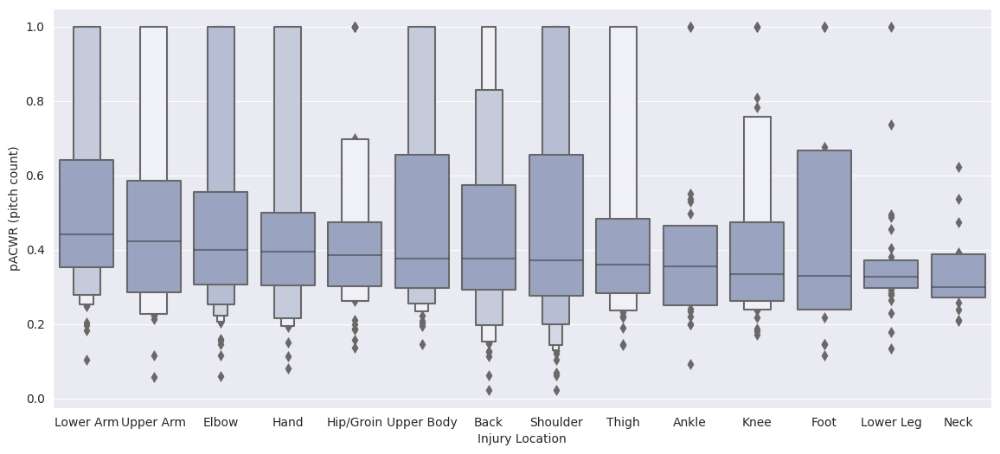

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('ggplot')
sns.set_style('darkgrid')
fig = plt.subplots(figsize=(14, 6))
df = df[df['injury_location'].isin(inj_loc)]
ax = sns.boxenplot(df, x='injury_location', y='pACWR_pitch_count', order=inj_loc, color='#93A1C8')
ax.set_xlabel('Injury Location')
ax.set_ylabel('pACWR (pitch count)')

In [ ]:
df.columns

Index(['game_date', 'pos', 'injury_type', 'injury_location', 'player_name',
       'avg_speed', 'avg_spin_rate', 'pct_fastball', 'pct_slider',
       'pct_sinker', 'pct_changup', 'pct_cutter', 'pACWR_pitch_count',
       'pACWR_spin_rate', 'pACWR_speed', 'pACWR_batters_faced'],
      dtype='object')

In [ ]:
df[df.columns[-4:]].corr()

,pACWR_pitch_count,pACWR_spin_rate,pACWR_speed,pACWR_batters_faced
pACWR_pitch_count,1.000000,0.037179,0.005563,0.991649
pACWR_spin_rate,0.037179,1.000000,0.104120,0.040837
pACWR_speed,0.005563,0.104120,1.000000,0.009301
pACWR_batters_faced,0.991649,0.040837,0.009301,1.000000


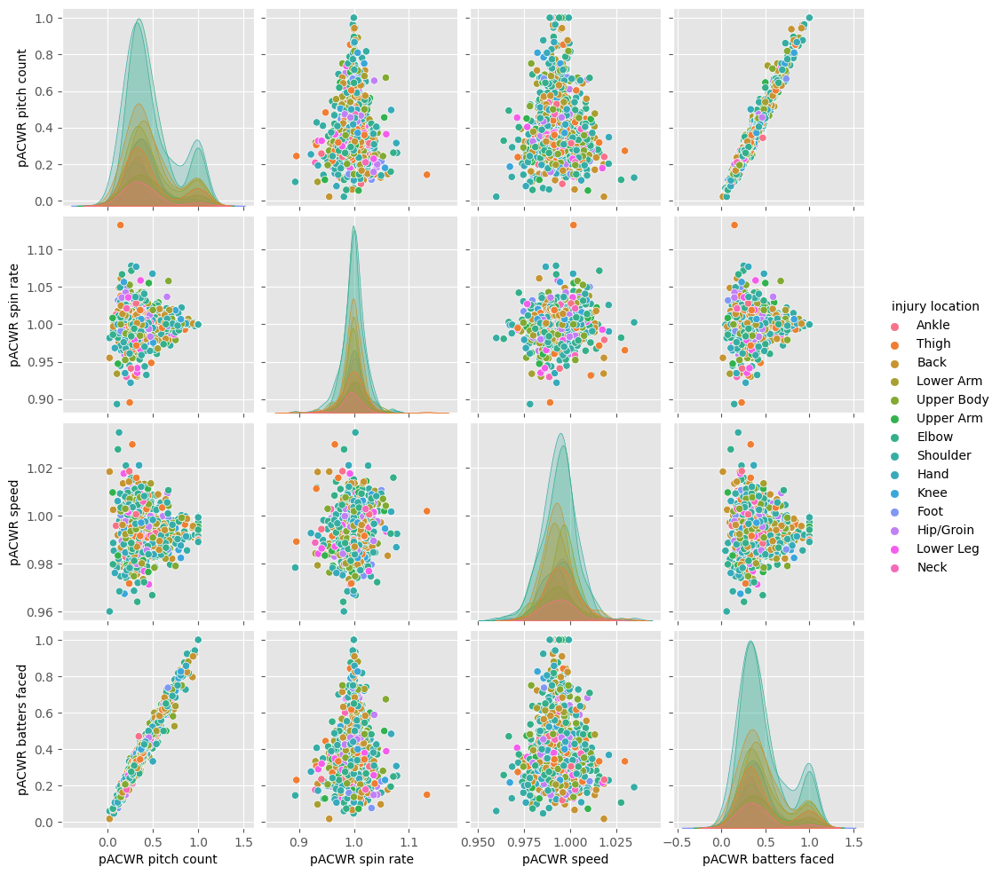

In [ ]:
plt.style.use('ggplot')

# Create the pairplot
viz_df = df[['injury_location', *df.columns[-4:]]]
viz_df.columns = [col.replace('_', ' ') for col in viz_df.columns]
sns.pairplot(viz_df, hue='injury location')

# Customize the plot (optional)
# You can adjust aesthetics using various seaborn arguments
# sns.pairplot(data[vars_to_plot], hue="feature4")  # Color by category
# sns.pairplot(data[vars_to_plot], diag_kind="hist")  # Histograms on diagonal

plt.show()

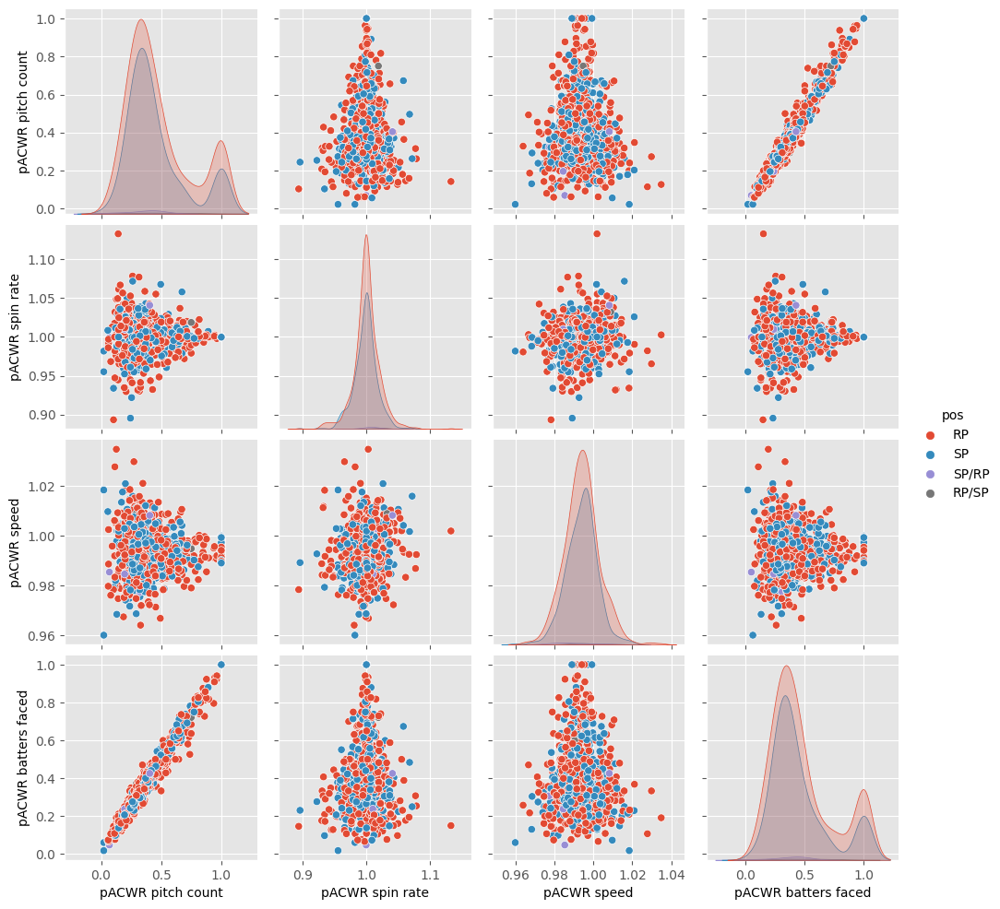

In [ ]:
plt.style.use('ggplot')

# Create the pairplot
viz_df = df[['pos', *df.columns[-4:]]]
viz_df.columns = [col.replace('_', ' ') for col in viz_df.columns]
sns.pairplot(viz_df, hue='pos')

# Customize the plot (optional)
# You can adjust aesthetics using various seaborn arguments
# sns.pairplot(data[vars_to_plot], hue="feature4")  # Color by category
# sns.pairplot(data[vars_to_plot], diag_kind="hist")  # Histograms on diagonal

plt.show()